<a href="https://colab.research.google.com/github/Rohitchavan03/Detect-and-classify-objects-within-images/blob/main/Detect_and_classify_oriented_objects(cars)_within_images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Develop a model that can detect and classify oriented objects(cars) within images.**

In [ ]:
import tensorflow as tf
from keras import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense


In [ ]:
from keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(rescale=1.0/255)  # Rescale pixel values to [0, 1]

train_generator = datagen.flow_from_directory(
    '/content/drive/MyDrive/ML task',
    target_size=(150, 150),  # Resize images to a common size
    batch_size=2,  # Adjust batch size based on available memory
    class_mode='categorical'  # Use categorical labels for multiple classes
)


Found 14 images belonging to 1 classes.


In [ ]:
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dense(3, activation='softmax')  # 3 output classes (cats, dogs, birds)
])


In [ ]:
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [ ]:
model.fit(train_generator, epochs=10)  # Adjust the number of epochs as needed


Epoch 1/10
7/7 [==============================] - 19s 915ms/step - loss: 9.9640 - accuracy: 0.7143
Epoch 2/10
7/7 [==============================] - 0s 43ms/step - loss: 65.4967 - accuracy: 0.5714
Epoch 3/10
7/7 [==============================] - 0s 53ms/step - loss: 185.8828 - accuracy: 0.7143
Epoch 4/10
7/7 [==============================] - 0s 53ms/step - loss: 526.9786 - accuracy: 0.4286
Epoch 5/10
7/7 [==============================] - 0s 50ms/step - loss: 1088.4017 - accuracy: 0.2857
Epoch 6/10
7/7 [==============================] - 0s 53ms/step - loss: 4291.5850 - accuracy: 0.5714
Epoch 7/10
7/7 [==============================] - 0s 28ms/step - loss: 3508.4331 - accuracy: 0.4286
Epoch 8/10
7/7 [==============================] - 0s 51ms/step - loss: 17964.5098 - accuracy: 0.0000e+00
Epoch 9/10
7/7 [==============================] - 0s 26ms/step - loss: 16466.0352 - accuracy: 0.4286
Epoch 10/10
7/7 [==============================] - 0s 53ms/step - loss: 31014.8574 - accuracy: 0.28

In [ ]:
# For running inference on the TF-Hub module.
import tensorflow as tf

import tensorflow_hub as hub

# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# For drawing onto the image.
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

# For measuring the inference time.
import time

# Print Tensorflow version
print(tf.__version__)

# Check available GPU devices.
print("The following GPU devices are available: %s" % tf.test.gpu_device_name())
module_handle = 'https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1'

2.13.0
The following GPU devices are available: /device:GPU:0


In [ ]:
x_train, y_train = train_generator.next()

In [ ]:
model = hub.load(module_handle)

In [ ]:
model.signatures.keys()

KeysView(_SignatureMap({'default': <ConcreteFunction pruned(images) at 0x7AA089AE44F0>}))

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
detector = model.signatures['default']

In [ ]:
def display_image(image):
    """
    Displays an image inside the notebook.
    This is used by download_and_resize_image()
    """
    fig = plt.figure(figsize=(20, 15))
    plt.grid(False)
    plt.imshow(image)


def download_and_resize_image(url, new_width=256, new_height=256, display=False):
    '''
    Fetches an image online, resizes it and saves it locally.

    Args:
        url (string) -- link to the image
        new_width (int) -- size in pixels used for resizing the width of the image
        new_height (int) -- size in pixels used for resizing the length of the image

    Returns:
        (string) -- path to the saved image
    '''


    # create a temporary file ending with ".jpg"
    _, filename = tempfile.mkstemp(suffix=".jpg")

    # opens the given URL
    response = urlopen(url)

    # reads the image fetched from the URL
    image_data = response.read()

    # puts the image data in memory buffer
    image_data = BytesIO(image_data)

    # opens the image
    pil_image = Image.open(image_data)

    # resizes the image. will crop if aspect ratio is different.
    pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)

    # converts to the RGB colorspace
    pil_image_rgb = pil_image.convert("RGB")

    # saves the image to the temporary file created earlier
    pil_image_rgb.save(filename, format="JPEG", quality=90)

    print("Image downloaded to %s." % filename)

    if display:
        display_image(pil_image)


    return filename

In [ ]:
def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):

    """
    Adds a bounding box to an image.

    Args:
        image -- the image object
        ymin -- bounding box coordinate
        xmin -- bounding box coordinate
        ymax -- bounding box coordinate
        xmax -- bounding box coordinate
        color -- color for the bounding box edges
        font -- font for class label
        thickness -- edge thickness of the bounding box
        display_str_list -- class labels for each object detected


    Returns:
        No return.  The function modifies the `image` argument
                    that gets passed into this function

    """
    draw = ImageDraw.Draw(image)
    im_width, im_height = image.size

    # scale the bounding box coordinates to the height and width of the image
    (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)

    # define the four edges of the detection box
    draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
             (left, top)],
            width=thickness,
            fill=color)

    # If the total height of the display strings added to the top of the bounding
    # box exceeds the top of the image, stack the strings below the bounding box
    # instead of above.
    display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
    # Each display_str has a top and bottom margin of 0.05x.
    total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

    if top > total_display_str_height:
        text_bottom = top
    else:
        text_bottom = top + total_display_str_height

    # Reverse list and print from bottom to top.
    for display_str in display_str_list[::-1]:
        text_width, text_height = font.getsize(display_str)
        margin = np.ceil(0.05 * text_height)
        draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                        (left + text_width, text_bottom)],
                       fill=color)
        draw.text((left + margin, text_bottom - text_height - margin),
                  display_str,
                  fill="black",
                  font=font)
        text_bottom -= text_height - 2 * margin


def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.1):
    """
    Overlay labeled boxes on an image with formatted scores and label names.

    Args:
        image -- the image as a numpy array
        boxes -- list of detection boxes
        class_names -- list of classes for each detected object
        scores -- numbers showing the model's confidence in detecting that object
        max_boxes -- maximum detection boxes to overlay on the image (default is 10)
        min_score -- minimum score required to display a bounding box

    Returns:
        image -- the image after detection boxes and classes are overlaid on the original image.
    """
    colors = list(ImageColor.colormap.values())

    try:
        font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
                              25)
    except IOError:
        print("Font not found, using default font.")
        font = ImageFont.load_default()

    for i in range(min(boxes.shape[0], max_boxes)):

        # only display detection boxes that have the minimum score or higher
        if scores[i] >= min_score:
            ymin, xmin, ymax, xmax = tuple(boxes[i])
            display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                         int(100 * scores[i]))
            color = colors[hash(class_names[i]) % len(colors)]
            image_pil = Image.fromarray(np.uint8(image)).convert("RGB")

            # draw one bounding box and overlay the class labels onto the image
            draw_bounding_box_on_image(image_pil,
                                       ymin,
                                       xmin,
                                       ymax,
                                       xmax,
                                       color,
                                       font,
                                       display_str_list=[display_str])
            np.copyto(image, np.array(image_pil))

    return image

In [ ]:
def load_img(path):
    '''
    Loads a JPEG image and converts it to a tensor.

    Args:
        path (string) -- path to a locally saved JPEG image

    Returns:
        (tensor) -- an image tensor
    '''

    # read the file
    img = tf.io.read_file(path)

    # convert to a tensor
    img = tf.image.decode_jpeg(img, channels=3)

    return img


def run_detector(detector, path):
    '''
    Runs inference on a local file using an object detection model.

    Args:
        detector (model) -- an object detection model loaded from TF Hub
        path (string) -- path to an image saved locally
    '''

    # load an image tensor from a local file path
    img = load_img(path)

    # add a batch dimension in front of the tensor
    converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]

    # run inference using the model
    start_time = time.time()
    result = detector(converted_img)
    end_time = time.time()

    # save the results in a dictionary
    result = {key:value.numpy() for key,value in result.items()}

    # print results
    print("Found %d objects." % len(result["detection_scores"]))
    print("Inference time: ", end_time-start_time)

    # draw predicted boxes over the image
    image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])

    # display the image
    display_image(image_with_boxes)

In [ ]:
# run_detector(detector, '/content/drive/MyDrive/ML task/ML task dataset/car10.jpg')

In [ ]:
import os
path = '/content/drive/MyDrive/ML task/ML task dataset/'
counter = 1
for filename in os.listdir(path):
  if filename.endswith('.jpg'):
    nf = str(counter)+'.jpg'
    os.rename(os.path.join(path, filename), os.path.join(path, nf))
    counter += 1

Found 100 objects.
Inference time:  1.1550531387329102


<ipython-input-14-8be463631219>:47: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
<ipython-input-14-8be463631219>:58: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


Found 100 objects.
Inference time:  1.225572109222412
Found 100 objects.
Inference time:  1.2158050537109375
Found 100 objects.
Inference time:  1.3435580730438232
Found 100 objects.
Inference time:  1.1749458312988281
Found 100 objects.
Inference time:  1.3108866214752197
Found 100 objects.
Inference time:  1.4773147106170654
Found 100 objects.
Inference time:  1.5952844619750977
Found 100 objects.
Inference time:  1.4098670482635498
Found 100 objects.
Inference time:  1.537562608718872
Found 100 objects.
Inference time:  1.5370416641235352
Found 100 objects.
Inference time:  1.6849541664123535
Found 100 objects.
Inference time:  1.6012775897979736
Found 100 objects.
Inference time:  1.4583745002746582


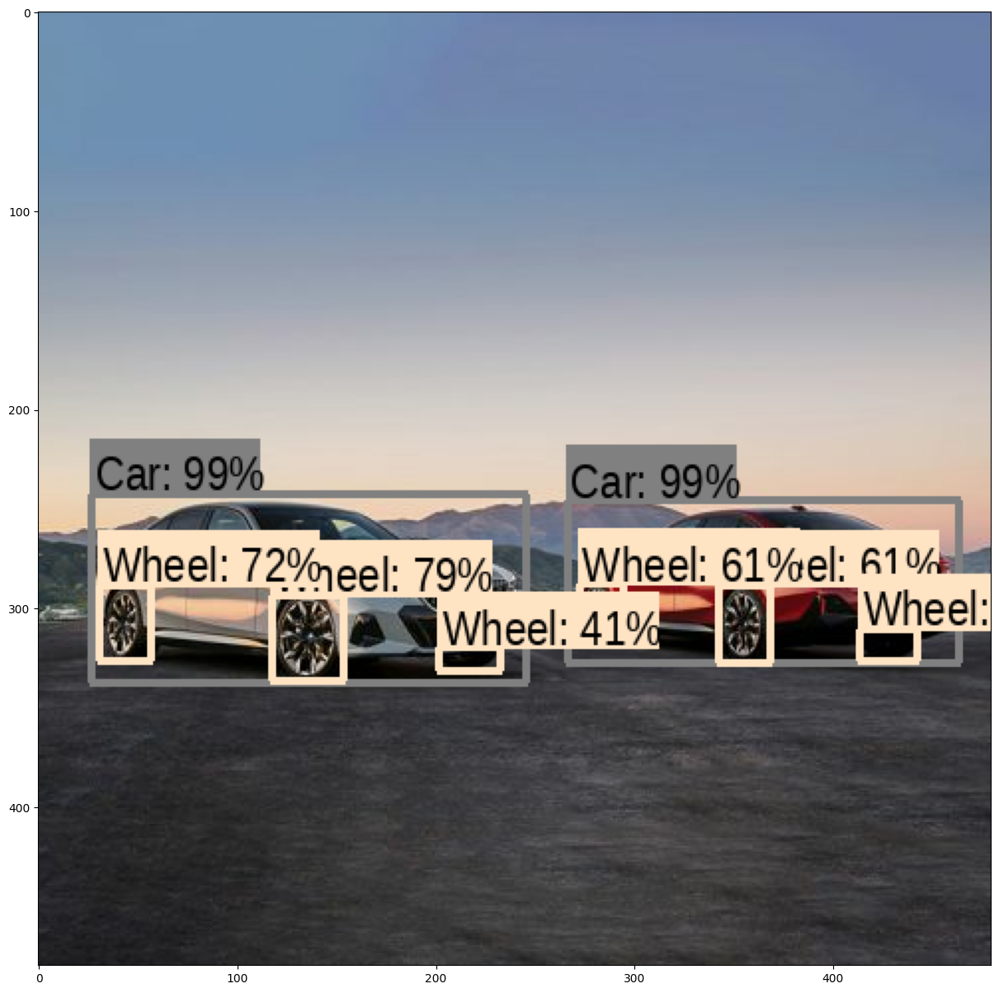

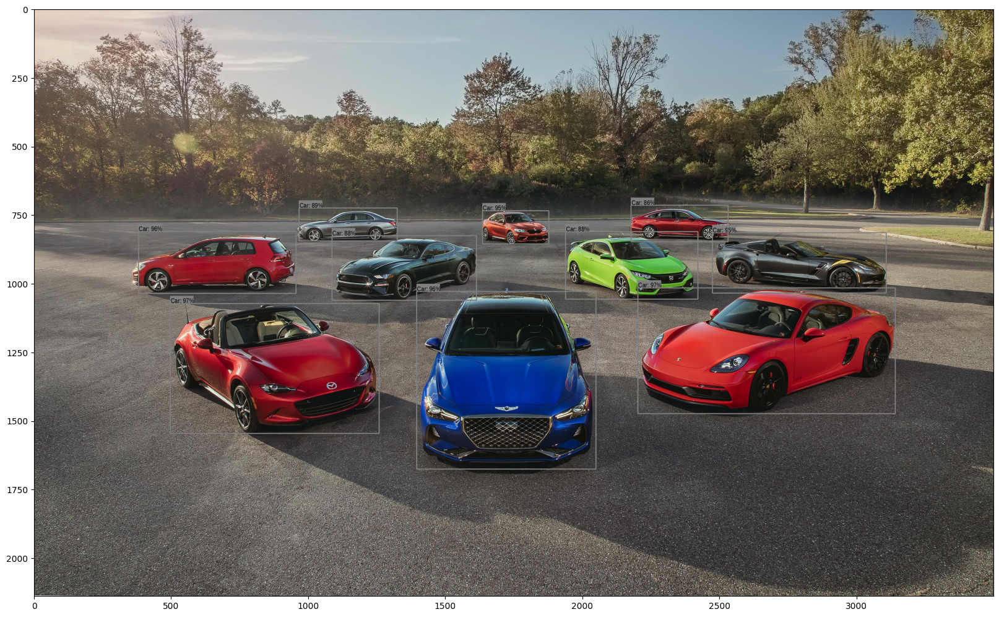

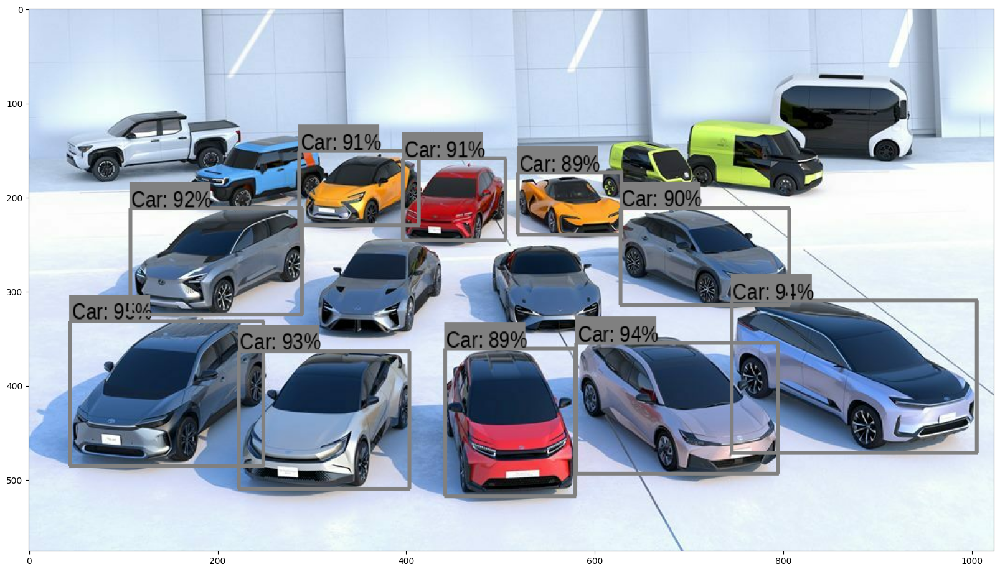

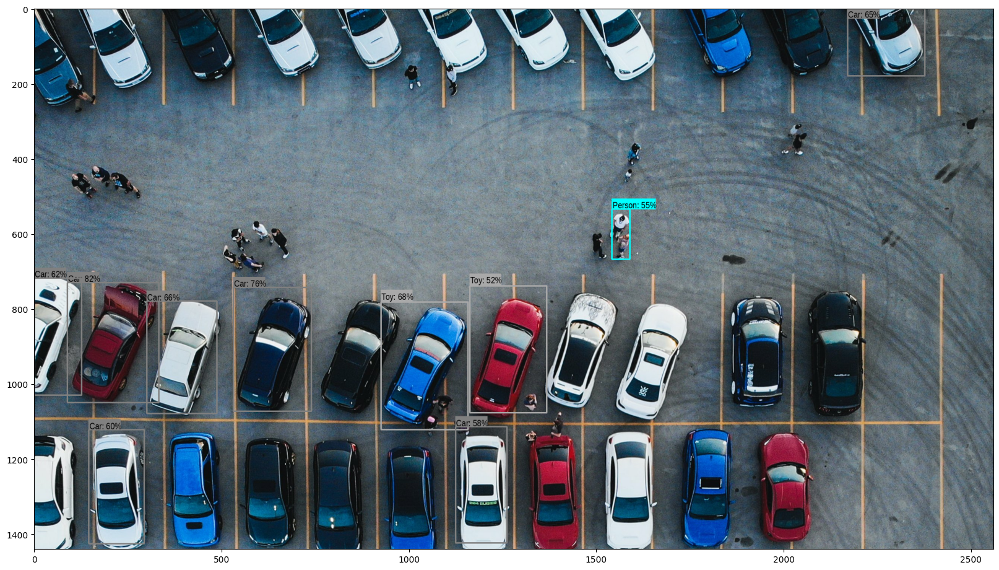

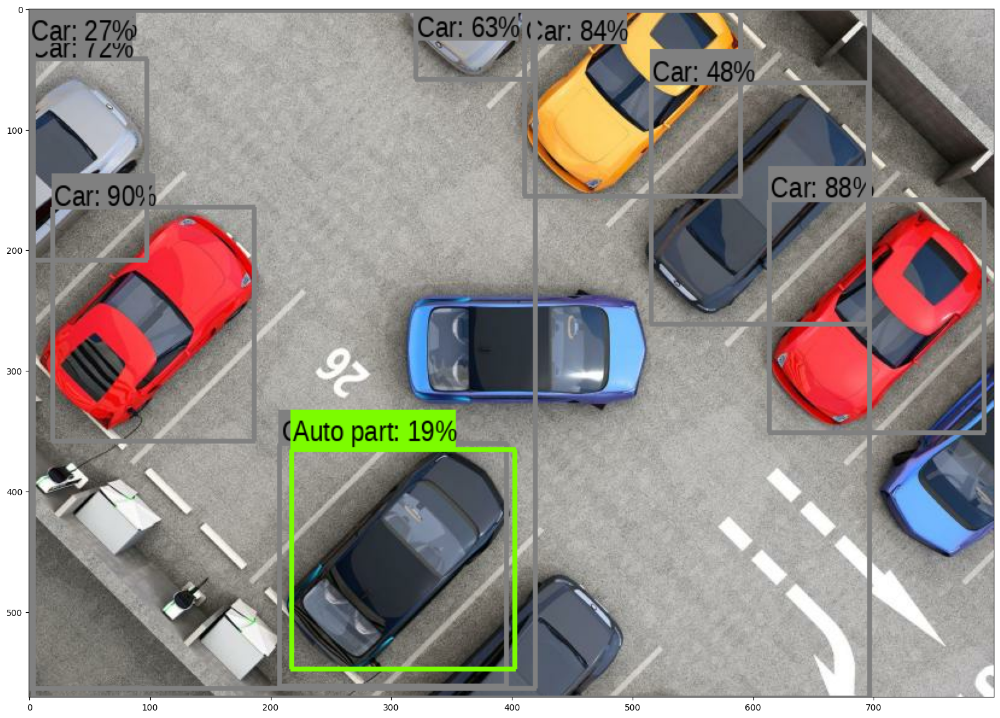

...

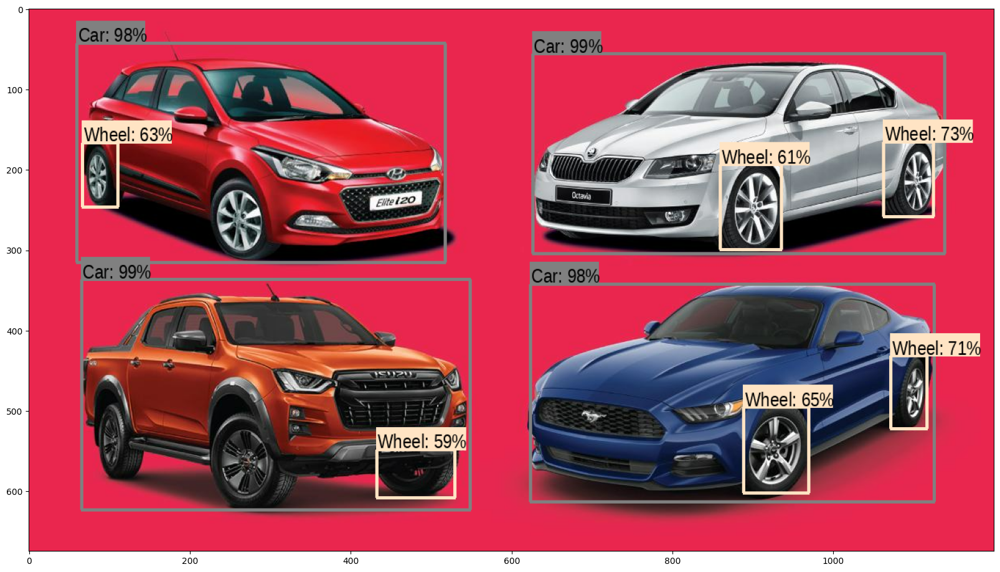

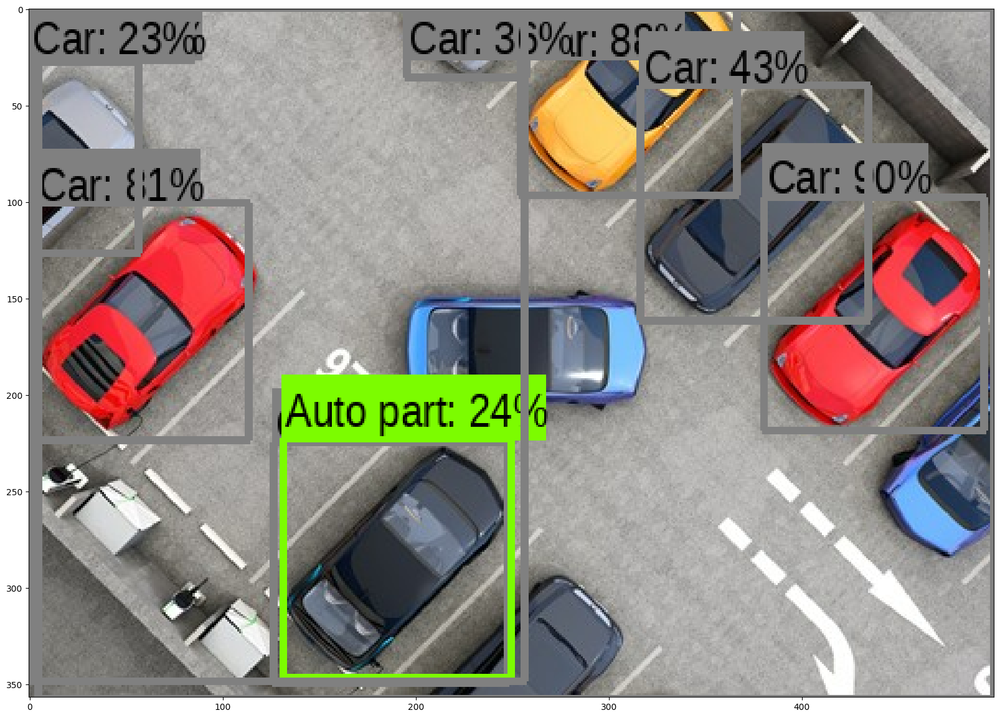

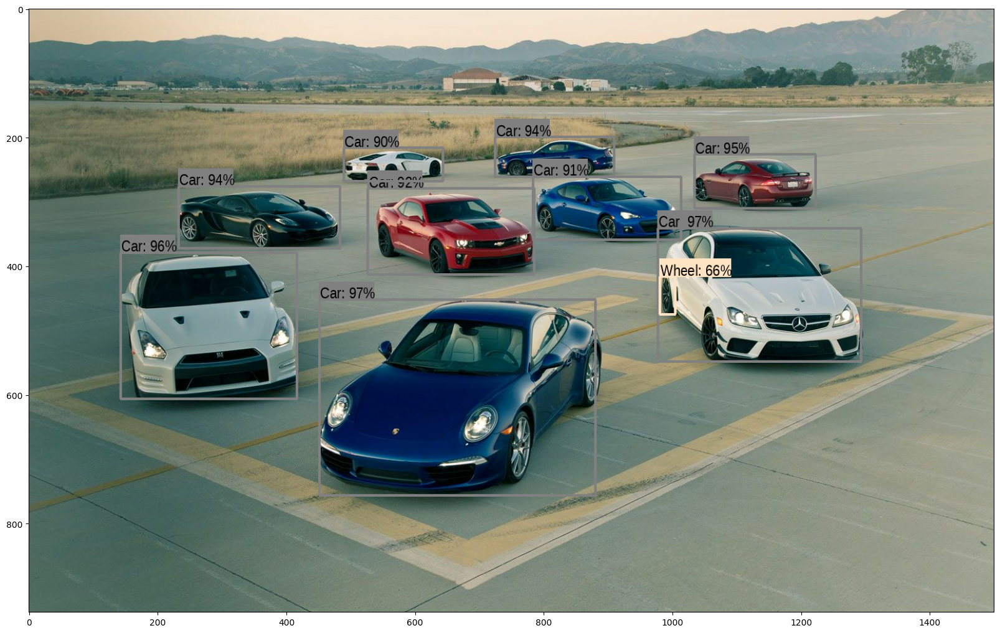

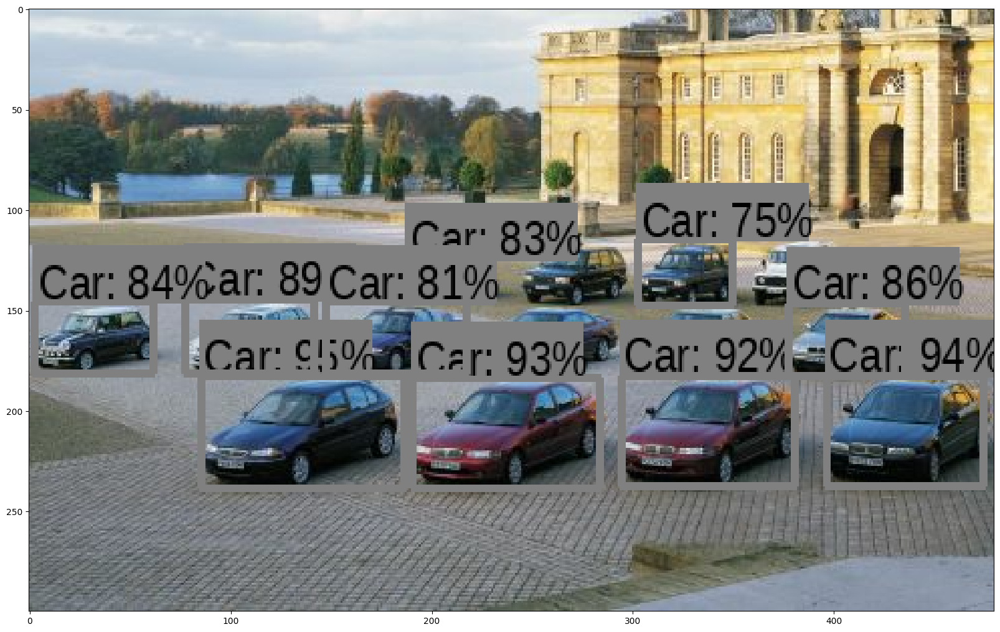

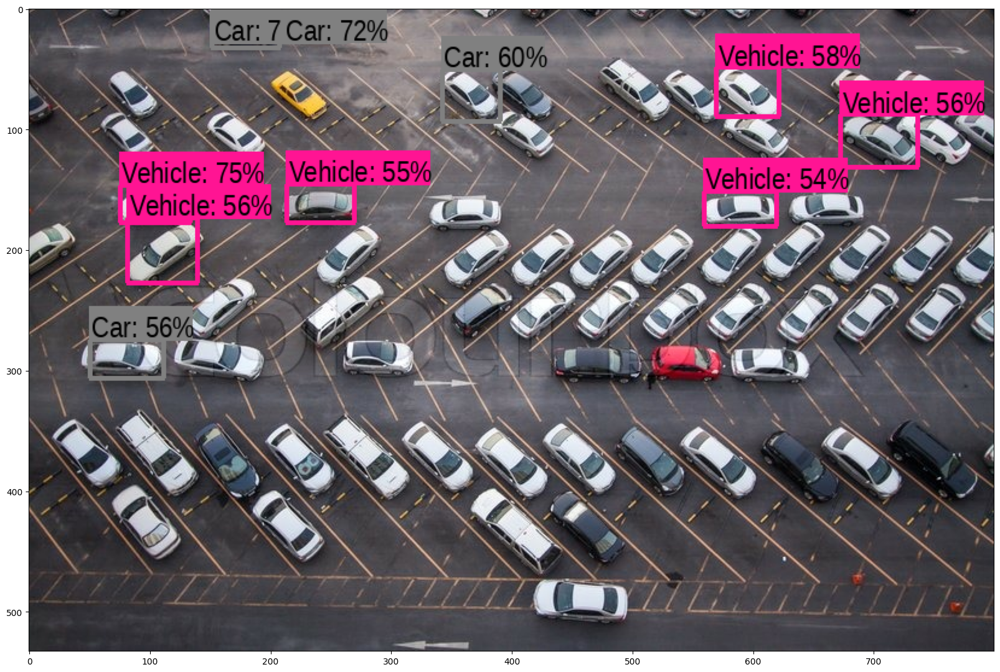

In [ ]:
for i in range(1,15):
  run_detector(detector, f'/content/drive/MyDrive/ML task/ML task dataset/{i}.jpg')

In [ ]:
from google.colab.patches import cv2_imshow
cv2_imshow('/content/drive/MyDrive/ML task/car1.jpg')
cv2.imshow('')